In [1]:
import matplotlib.pyplot as plt
import numpy as np
import os, scipy
import matplotlib.colors as mcolors
import networkx as nx
import pickle
import copy
from numba.typed import Dict
from numba.core import types
import networkx as nx

# We import the model, stimuli, and the optimal control package
from neurolib.models.wc import WCModel
from neurolib.utils.stimulus import ZeroInput
from neurolib.control.optimal_control import oc_wc
from neurolib.control.optimal_control import cost_functions

import matplotlib as mpl
label_size= 20
mpl.rcParams['xtick.labelsize'] = label_size
mpl.rcParams['ytick.labelsize'] = label_size
mpl.rcParams['font.size'] = label_size
mpl.rcParams['axes.titlesize'] = label_size

# This will reload all imports as soon as the code changes
%load_ext autoreload
%autoreload 2

while "Promotion/neurolib" in os.getcwd():
    os.chdir('..')

def draw_nwgraph(cmat):
    G = nx.DiGraph() 
    for n in range(cmat.shape[0]):
            for l in range(cmat.shape[1]):
                if cmat[n,l] != 0:
                    G.add_edge(l,n)
    nx.draw(G, with_labels=True, arrows=True, **options)
    plt.show()

options = {
'node_color': 'lightgray',
'node_size': 1000,
'width': 2,
'arrowstyle': '-|>',
'arrowsize': 20,
'font_size' : 20,
'font_weight' : 'bold',
}

In [2]:
N = 6

cmat = np.zeros((N,N) )
dmat = np.zeros((N,N) )

p = 0.4

for n1 in range(N):
    for n2 in range(N):
        if n1 == n2: continue
        if np.random.rand() < p:
            cmat[n1,n2] = 1
            dmat[n1,n2] = int(np.random.rand() * 20)

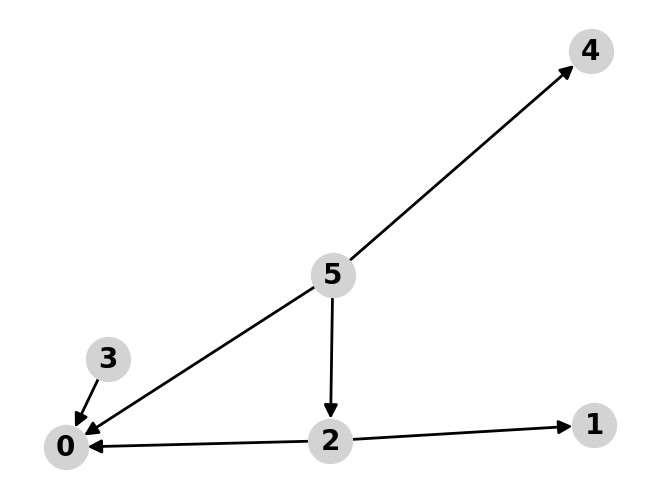

[[0. 0. 1. 1. 0. 1.]
 [0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 0. 0.]]
[[ 0.  0.  6. 10.  0. 16.]
 [ 0.  0. 18.  0.  0.  0.]
 [ 0.  0.  0.  0.  0. 14.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  6.]
 [ 0.  0.  0.  0.  0.  0.]]


In [31]:
N = 6

cmat = np.array([
 [0., 1., 1., 0., 1., 1.],
 [1., 0., 1., 1., 0., 1.],
 [1., 1., 0., 1., 1., 0.],
 [0., 1., 1., 0., 1., 1.],
 [1., 0., 1., 1., 0., 1.],
 [1., 1., 0., 0., 1., 0.]])

# chimera: non-local coupling in ring


dmat = np.zeros((cmat.shape))

for n1 in range(N):
    for n2 in range(N):
        if cmat[n1, n2] == 0: continue
        dmat[n1,n2] = int(np.random.rand() * 20)

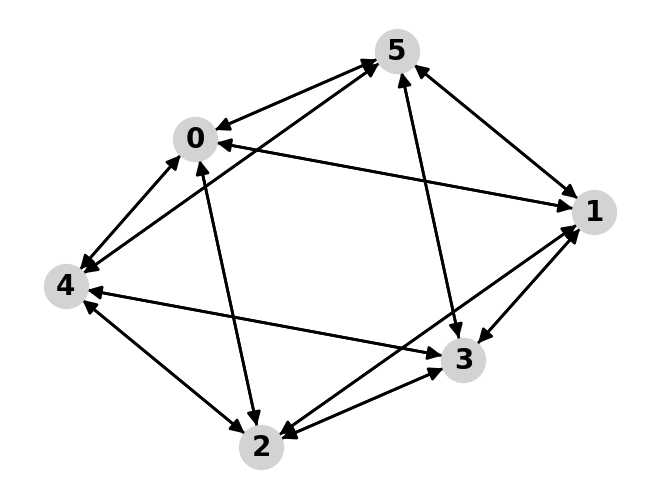

[[0. 1. 1. 0. 1. 1.]
 [1. 0. 1. 1. 0. 1.]
 [1. 1. 0. 1. 1. 0.]
 [0. 1. 1. 0. 1. 1.]
 [1. 0. 1. 1. 0. 1.]
 [1. 1. 0. 1. 1. 0.]]
[[ 0. 12.  4.  0. 14. 16.]
 [ 8.  0. 14.  7.  0.  2.]
 [ 7.  9.  0. 18. 18.  0.]
 [ 0.  1.  0.  0. 17. 19.]
 [ 3.  0.  6.  6.  0.  3.]
 [11.  3.  0. 13. 17.  0.]]


In [28]:
draw_nwgraph(cmat)

print(cmat)
print(dmat)

In [29]:
coupling_array = np.array( [0.4, 0.8] )

eext = np.arange(0., 3., 0.2)
iext = np.arange(0., 3., 0.2)

add_ind = 15000

----------------------------------------------------------- 0
0.0 0.0
0.0 0.2
0.0 0.4
0.0 0.6000000000000001
0.0 0.8
0.0 1.0
0.0 1.2000000000000002
0.0 1.4000000000000001
0.0 1.6
0.0 1.8
0.0 2.0
0.0 2.2
0.0 2.4000000000000004
0.0 2.6
0.0 2.8000000000000003
0.2 0.0
0.2 0.2
0.2 0.4
0.2 0.6000000000000001
0.2 0.8
0.2 1.0
0.2 1.2000000000000002
0.2 1.4000000000000001
0.2 1.6
0.2 1.8
0.2 2.0
0.2 2.2
0.2 2.4000000000000004
0.2 2.6
0.2 2.8000000000000003
0.4 0.0
0.4 0.2
0.4 0.4
0.4 0.6000000000000001
0.4 0.8
0.4 1.0
0.4 1.2000000000000002
0.4 1.4000000000000001
0.4 1.6
0.4 1.8
0.4 2.0
0.4 2.2
0.4 2.4000000000000004
0.4 2.6
0.4 2.8000000000000003
0.6000000000000001 0.0
0.6000000000000001 0.2
0.6000000000000001 0.4
0.6000000000000001 0.6000000000000001
0.6000000000000001 0.8
0.6000000000000001 1.0
0.6000000000000001 1.2000000000000002
0.6000000000000001 1.4000000000000001
0.6000000000000001 1.6
0.6000000000000001 1.8
0.6000000000000001 2.0
0.6000000000000001 2.2
0.6000000000000001 2.40000000000

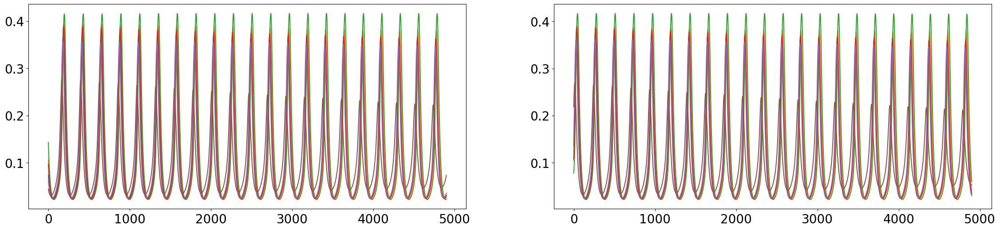

0.8 0.2


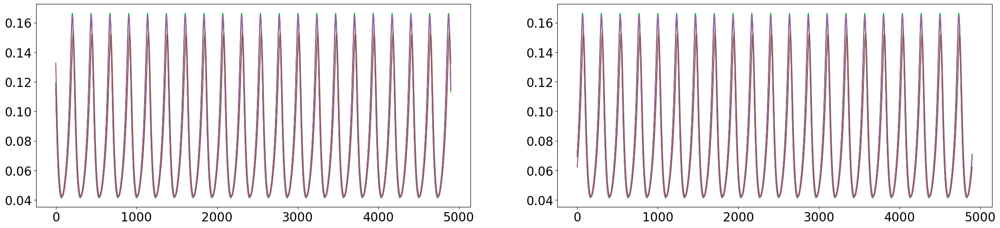

0.8 0.4
0.8 0.6000000000000001
0.8 0.8
0.8 1.0
0.8 1.2000000000000002
0.8 1.4000000000000001
0.8 1.6
0.8 1.8
0.8 2.0
0.8 2.2
0.8 2.4000000000000004
0.8 2.6
0.8 2.8000000000000003
1.0 0.0


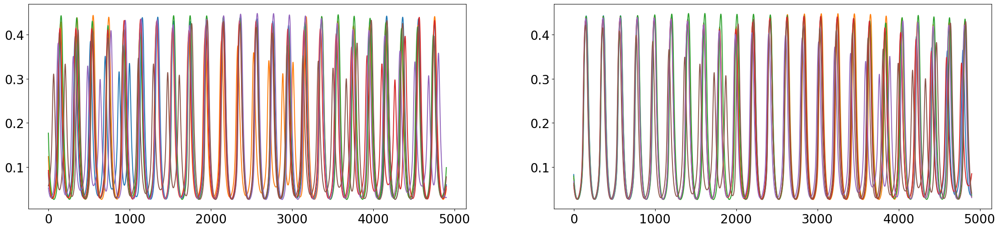

1.0 0.2


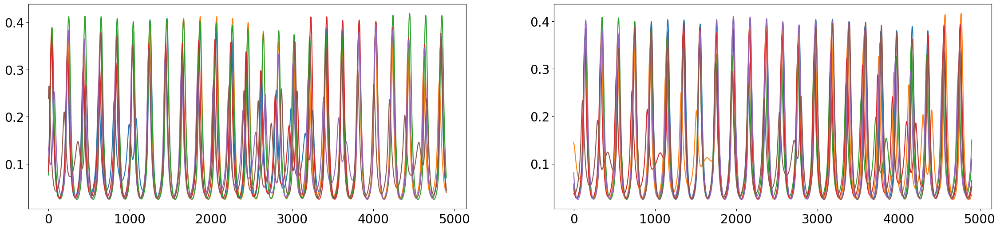

1.0 0.4


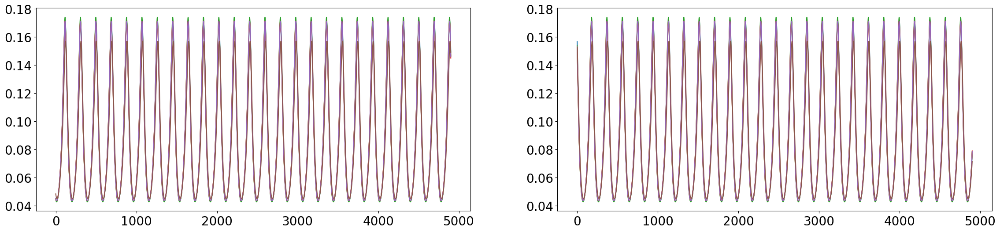

1.0 0.6000000000000001
1.0 0.8
1.0 1.0
1.0 1.2000000000000002
1.0 1.4000000000000001
1.0 1.6
1.0 1.8
1.0 2.0
1.0 2.2
1.0 2.4000000000000004
1.0 2.6
1.0 2.8000000000000003
1.2000000000000002 0.0


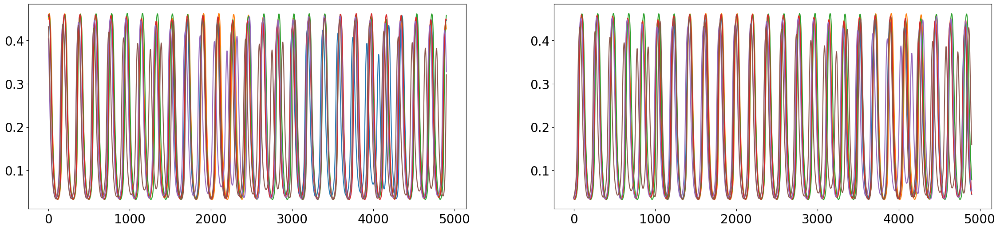

1.2000000000000002 0.2


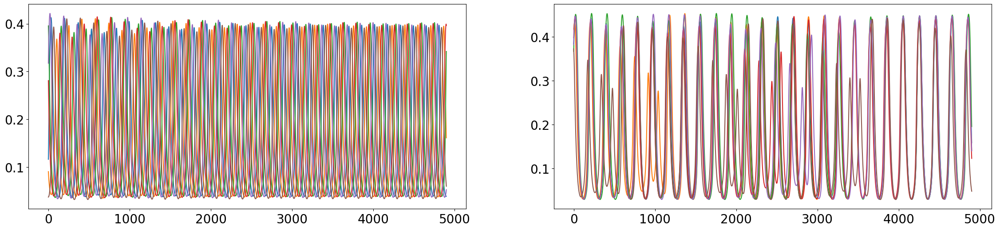

1.2000000000000002 0.4


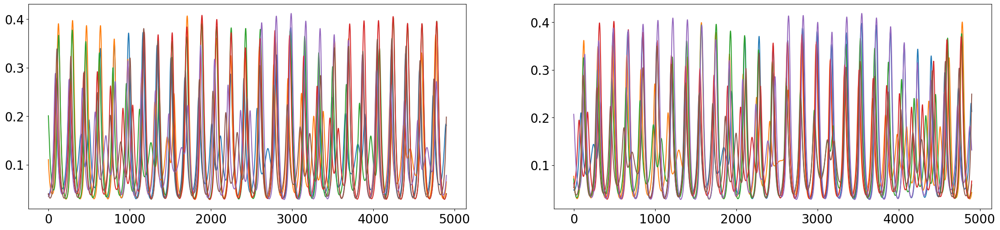

1.2000000000000002 0.6000000000000001


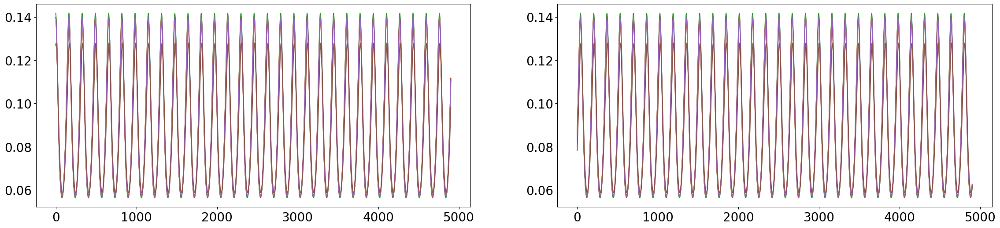

1.2000000000000002 0.8
1.2000000000000002 1.0
1.2000000000000002 1.2000000000000002
1.2000000000000002 1.4000000000000001
1.2000000000000002 1.6
1.2000000000000002 1.8
1.2000000000000002 2.0
1.2000000000000002 2.2
1.2000000000000002 2.4000000000000004
1.2000000000000002 2.6
1.2000000000000002 2.8000000000000003
1.4000000000000001 0.0


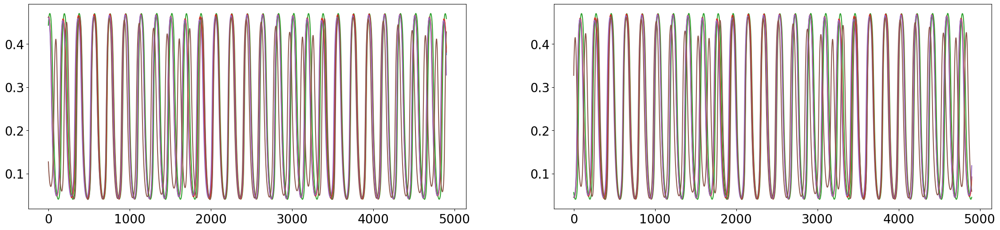

1.4000000000000001 0.2


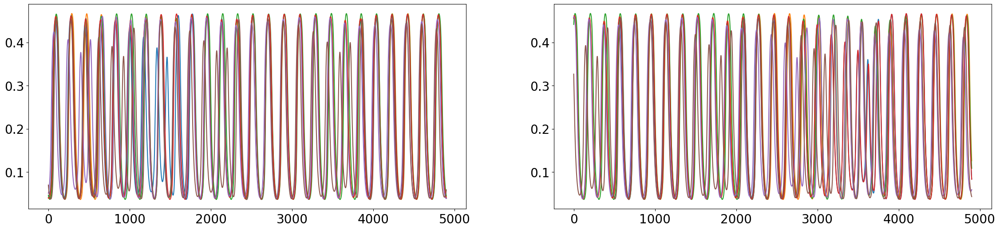

1.4000000000000001 0.4


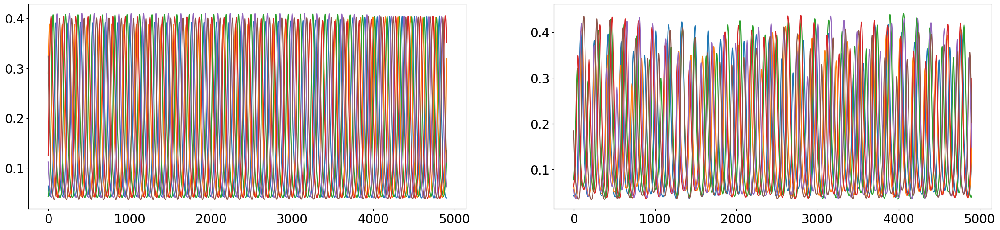

1.4000000000000001 0.6000000000000001


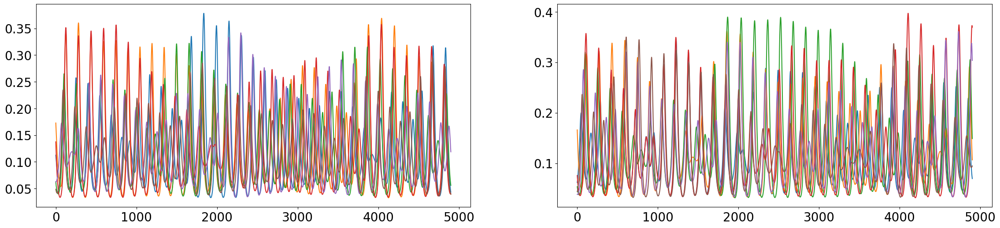

1.4000000000000001 0.8
1.4000000000000001 1.0
1.4000000000000001 1.2000000000000002
1.4000000000000001 1.4000000000000001
1.4000000000000001 1.6
1.4000000000000001 1.8
1.4000000000000001 2.0
1.4000000000000001 2.2
1.4000000000000001 2.4000000000000004
1.4000000000000001 2.6
1.4000000000000001 2.8000000000000003
1.6 0.0


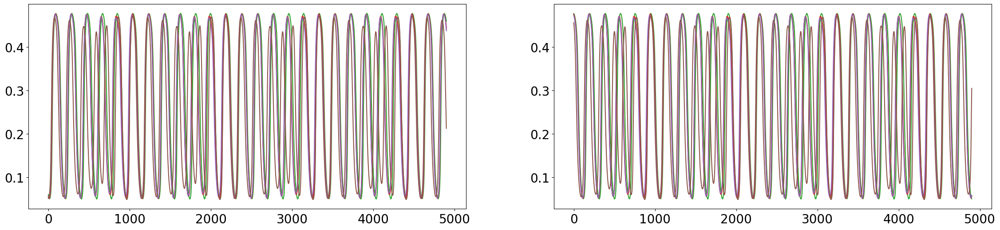

1.6 0.2


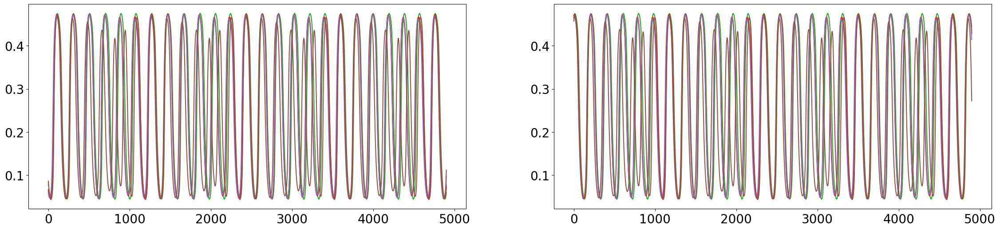

1.6 0.4


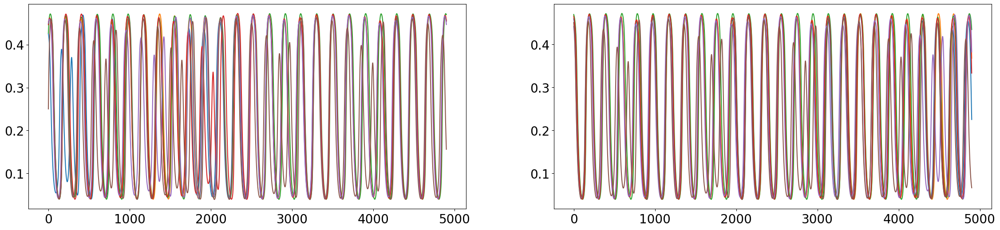

1.6 0.6000000000000001


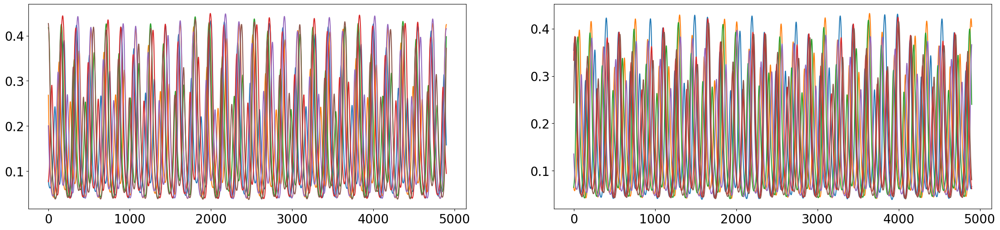

1.6 0.8


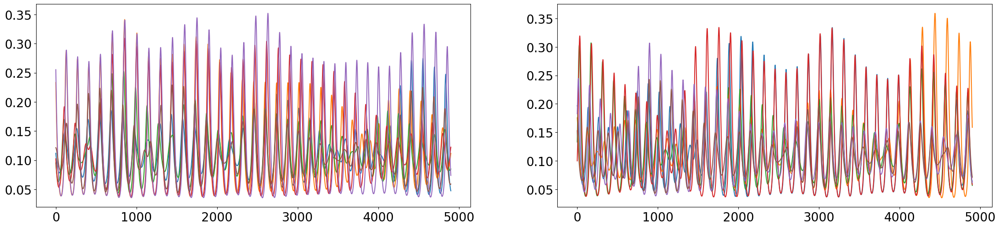

1.6 1.0
1.6 1.2000000000000002
1.6 1.4000000000000001
1.6 1.6
1.6 1.8
1.6 2.0
1.6 2.2
1.6 2.4000000000000004
1.6 2.6
1.6 2.8000000000000003
1.8 0.0


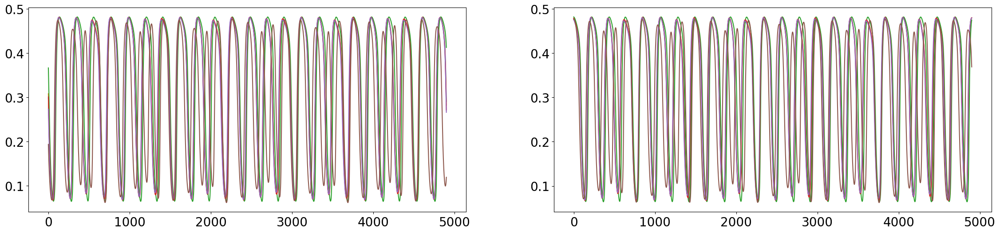

1.8 0.2


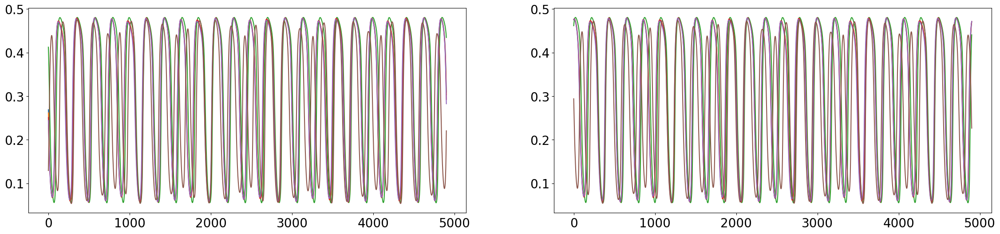

1.8 0.4


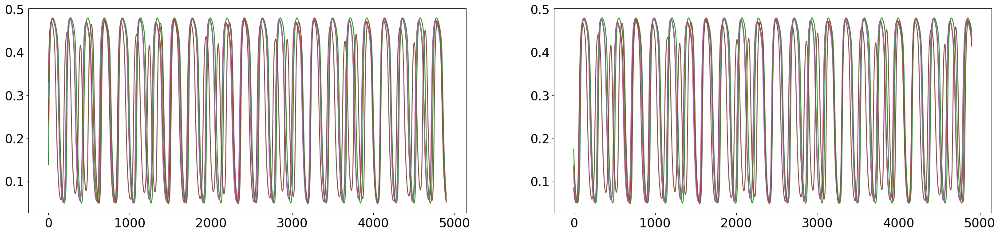

1.8 0.6000000000000001


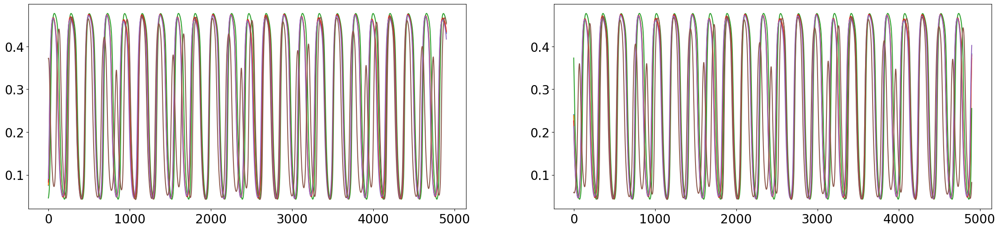

1.8 0.8


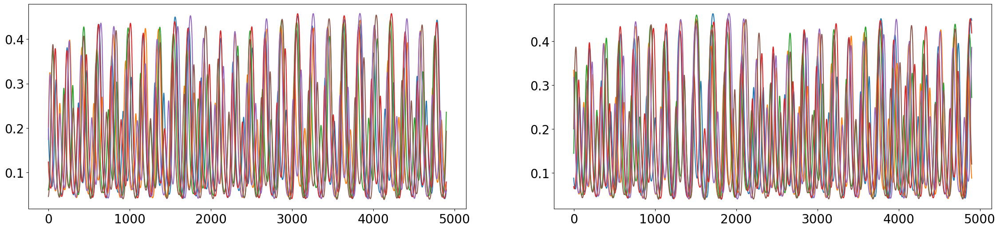

1.8 1.0


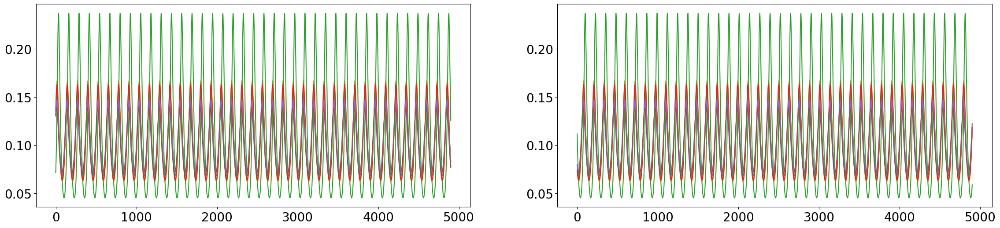

1.8 1.2000000000000002
1.8 1.4000000000000001
1.8 1.6
1.8 1.8
1.8 2.0
1.8 2.2
1.8 2.4000000000000004
1.8 2.6
1.8 2.8000000000000003
2.0 0.0


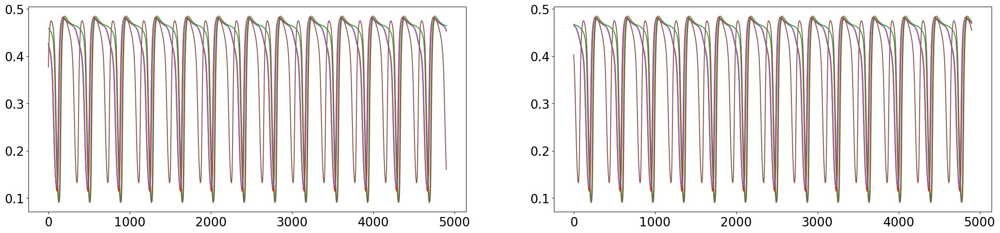

2.0 0.2


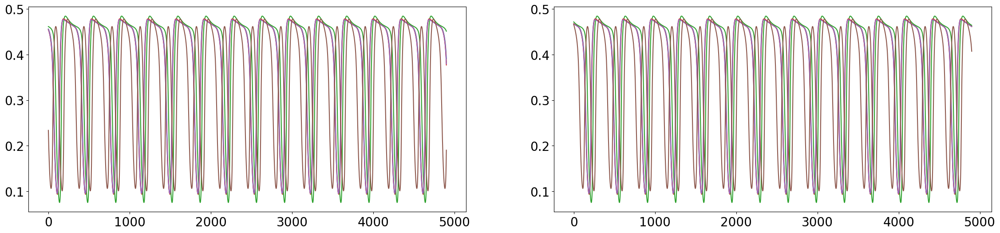

2.0 0.4


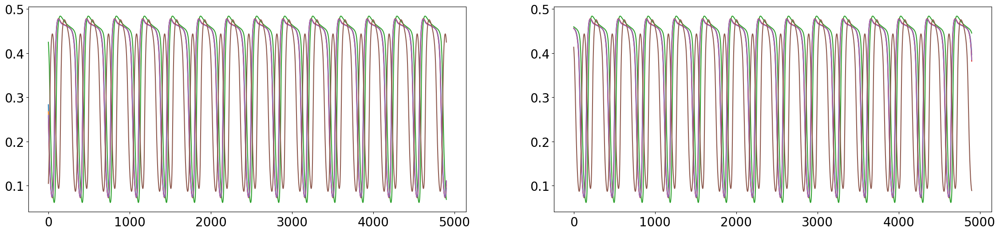

2.0 0.6000000000000001


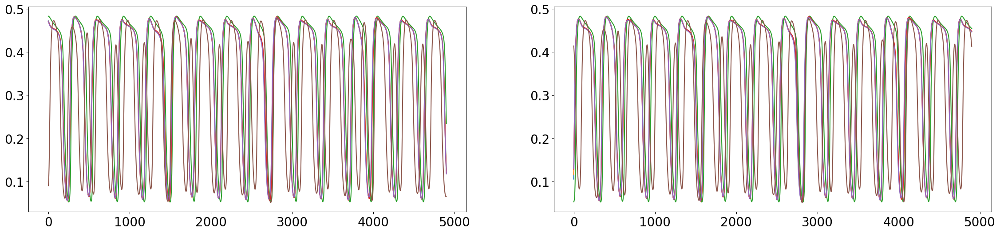

2.0 0.8


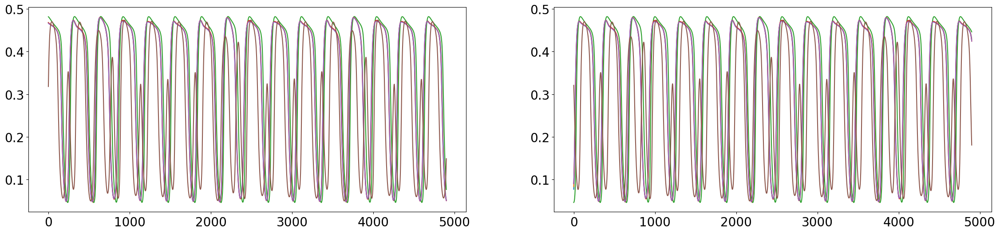

2.0 1.0


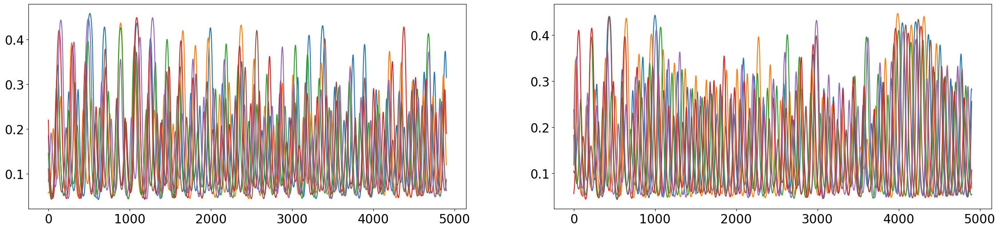

2.0 1.2000000000000002
2.0 1.4000000000000001
2.0 1.6
2.0 1.8
2.0 2.0
2.0 2.2
2.0 2.4000000000000004
2.0 2.6
2.0 2.8000000000000003
2.2 0.0
2.2 0.2
2.2 0.4
2.2 0.6000000000000001
2.2 0.8
2.2 1.0


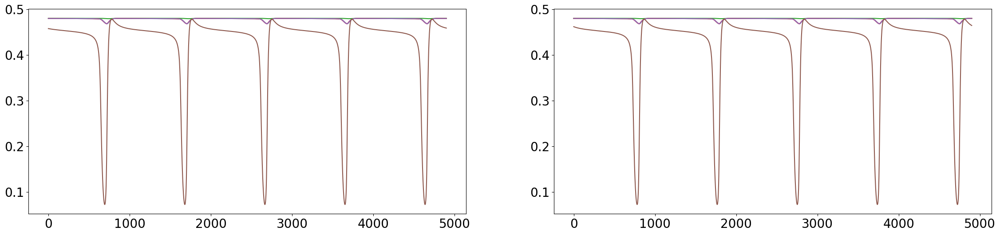

2.2 1.2000000000000002


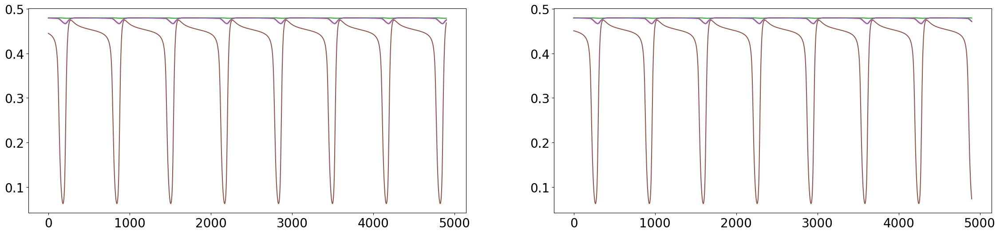

2.2 1.4000000000000001


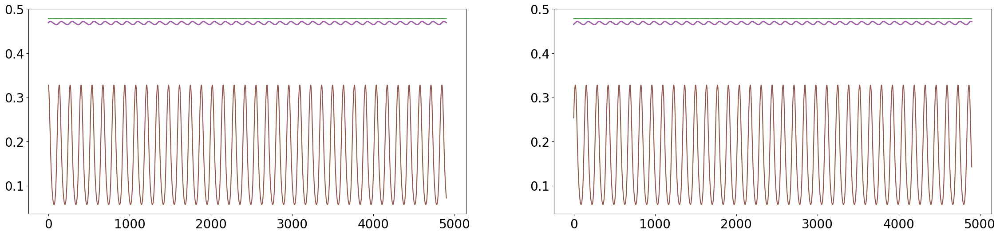

2.2 1.6
2.2 1.8
2.2 2.0
2.2 2.2
2.2 2.4000000000000004
2.2 2.6
2.2 2.8000000000000003
2.4000000000000004 0.0
2.4000000000000004 0.2
2.4000000000000004 0.4
2.4000000000000004 0.6000000000000001
2.4000000000000004 0.8
2.4000000000000004 1.0
2.4000000000000004 1.2000000000000002
2.4000000000000004 1.4000000000000001
2.4000000000000004 1.6
2.4000000000000004 1.8
2.4000000000000004 2.0
2.4000000000000004 2.2
2.4000000000000004 2.4000000000000004
2.4000000000000004 2.6
2.4000000000000004 2.8000000000000003
2.6 0.0
2.6 0.2
2.6 0.4
2.6 0.6000000000000001
2.6 0.8
2.6 1.0
2.6 1.2000000000000002
2.6 1.4000000000000001
2.6 1.6
2.6 1.8
2.6 2.0
2.6 2.2
2.6 2.4000000000000004
2.6 2.6
2.6 2.8000000000000003
2.8000000000000003 0.0
2.8000000000000003 0.2
2.8000000000000003 0.4
2.8000000000000003 0.6000000000000001
2.8000000000000003 0.8
2.8000000000000003 1.0
2.8000000000000003 1.2000000000000002
2.8000000000000003 1.4000000000000001
2.8000000000000003 1.6
2.8000000000000003 1.8
2.8000000000000003 2.0
2

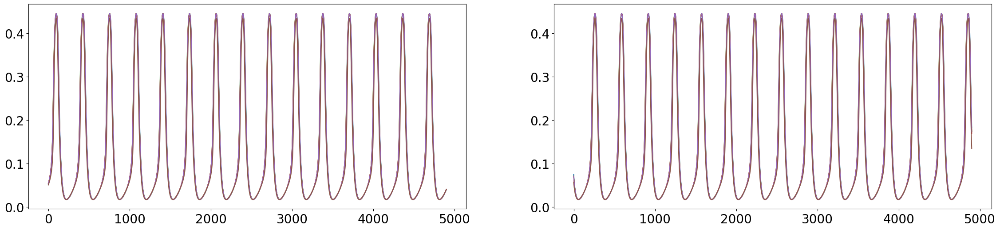

0.6000000000000001 0.2
0.6000000000000001 0.4
0.6000000000000001 0.6000000000000001
0.6000000000000001 0.8
0.6000000000000001 1.0
0.6000000000000001 1.2000000000000002
0.6000000000000001 1.4000000000000001
0.6000000000000001 1.6
0.6000000000000001 1.8
0.6000000000000001 2.0
0.6000000000000001 2.2
0.6000000000000001 2.4000000000000004
0.6000000000000001 2.6
0.6000000000000001 2.8000000000000003
0.8 0.0


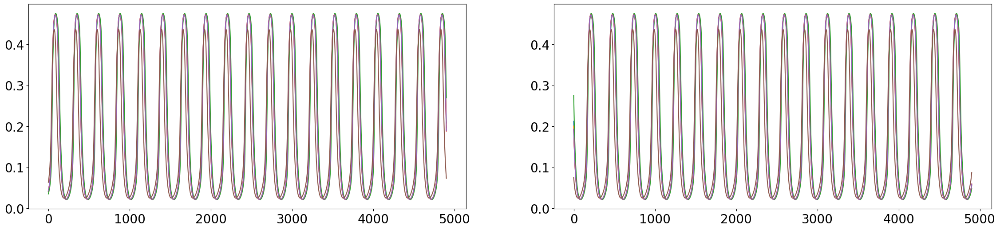

0.8 0.2


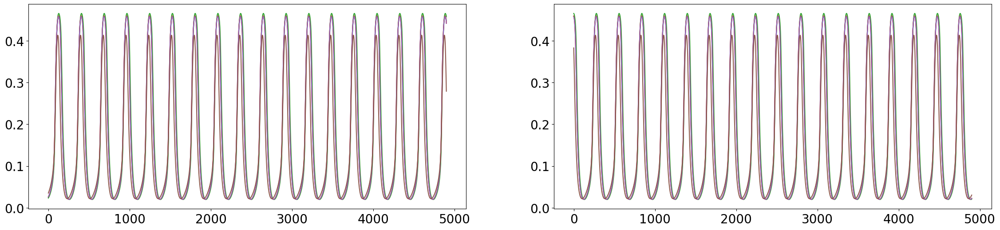

0.8 0.4


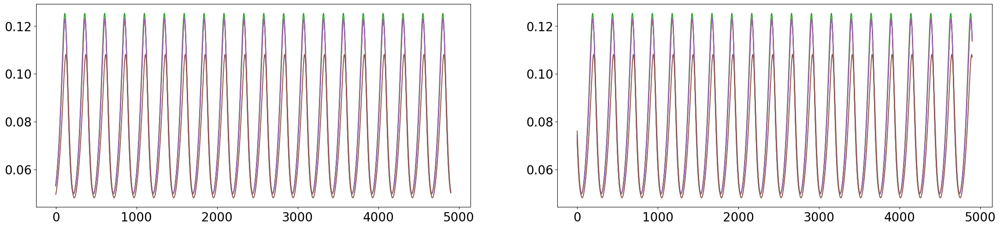

0.8 0.6000000000000001
0.8 0.8
0.8 1.0
0.8 1.2000000000000002
0.8 1.4000000000000001
0.8 1.6
0.8 1.8
0.8 2.0
0.8 2.2
0.8 2.4000000000000004
0.8 2.6
0.8 2.8000000000000003
1.0 0.0


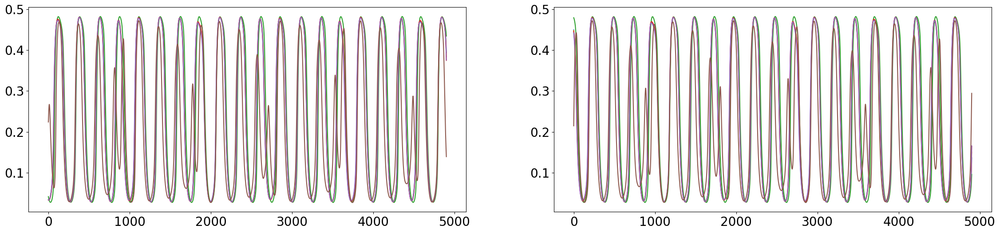

1.0 0.2


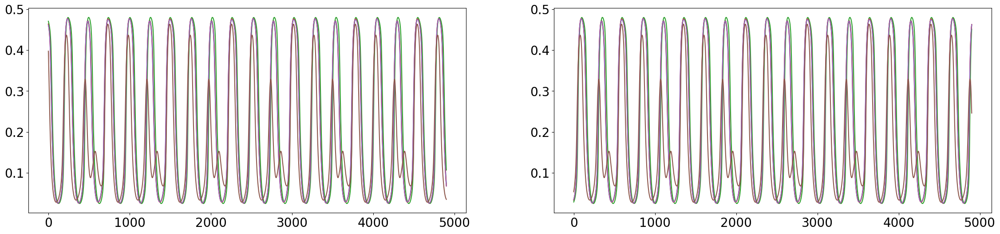

1.0 0.4


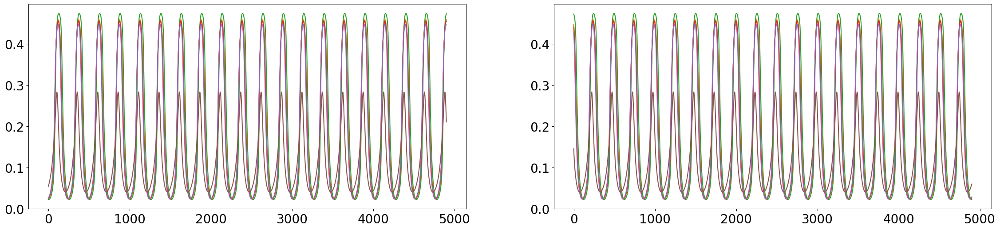

1.0 0.6000000000000001


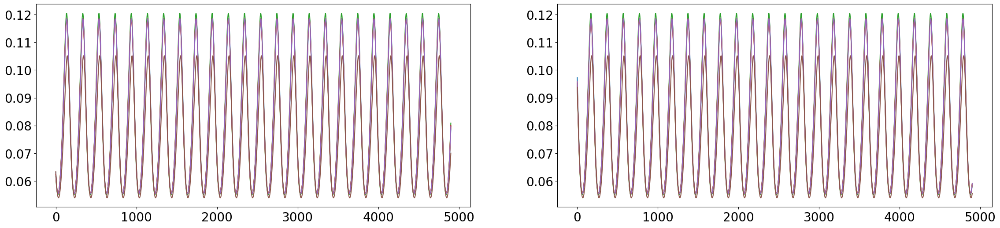

1.0 0.8
1.0 1.0
1.0 1.2000000000000002
1.0 1.4000000000000001
1.0 1.6
1.0 1.8
1.0 2.0
1.0 2.2
1.0 2.4000000000000004
1.0 2.6
1.0 2.8000000000000003
1.2000000000000002 0.0


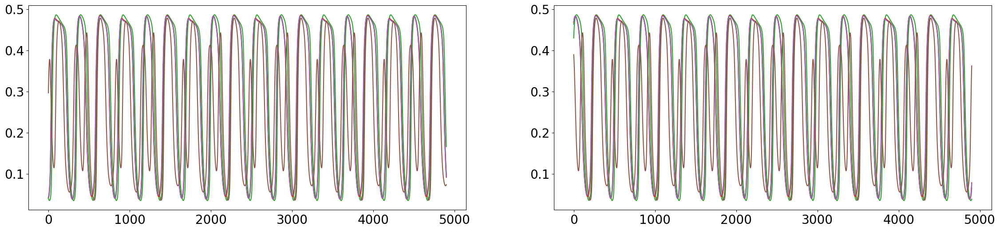

1.2000000000000002 0.2


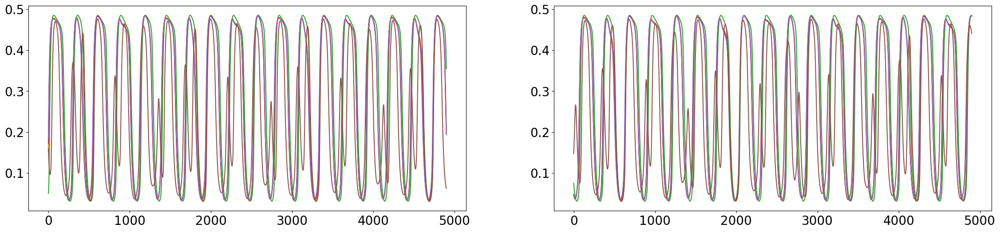

1.2000000000000002 0.4


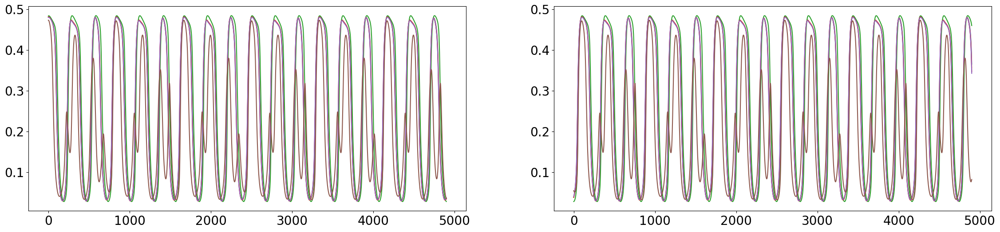

1.2000000000000002 0.6000000000000001


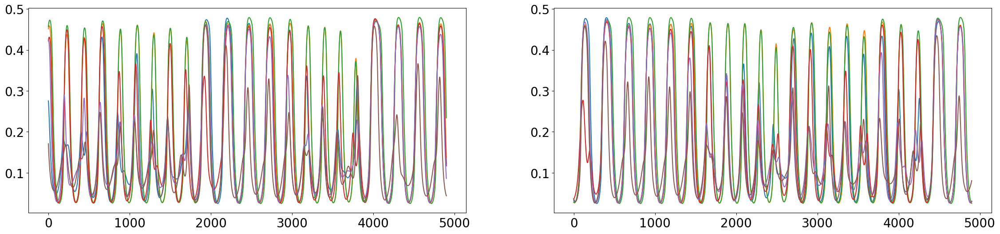

1.2000000000000002 0.8
1.2000000000000002 1.0
1.2000000000000002 1.2000000000000002
1.2000000000000002 1.4000000000000001
1.2000000000000002 1.6
1.2000000000000002 1.8
1.2000000000000002 2.0
1.2000000000000002 2.2
1.2000000000000002 2.4000000000000004
1.2000000000000002 2.6
1.2000000000000002 2.8000000000000003
1.4000000000000001 0.0


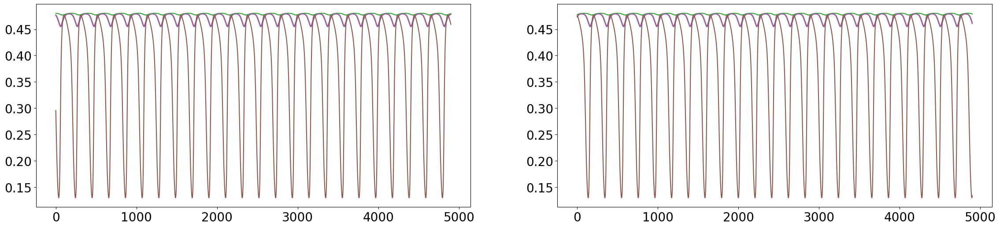

1.4000000000000001 0.2


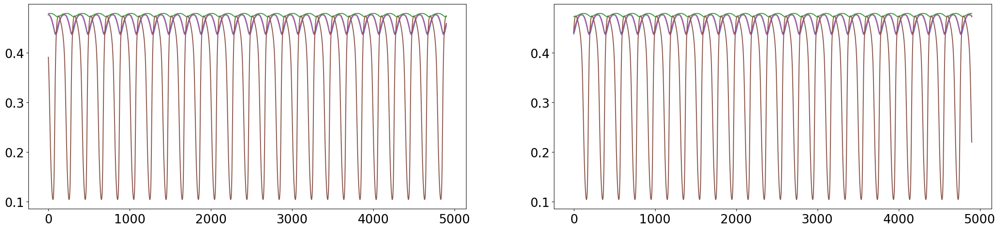

1.4000000000000001 0.4


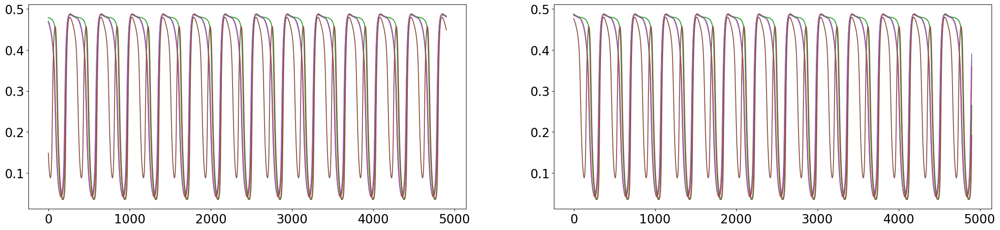

1.4000000000000001 0.6000000000000001


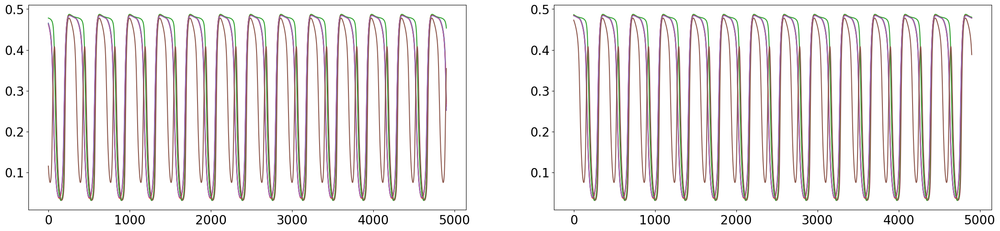

1.4000000000000001 0.8


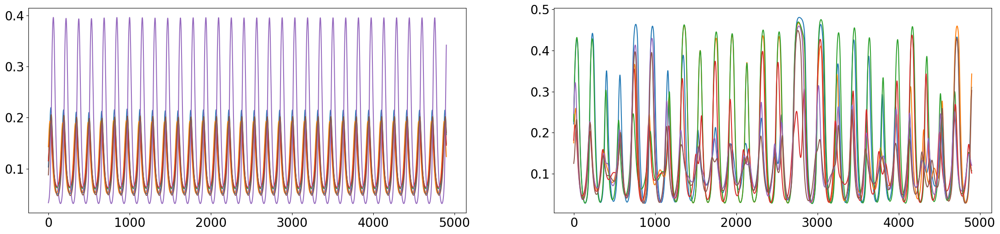

1.4000000000000001 1.0
1.4000000000000001 1.2000000000000002
1.4000000000000001 1.4000000000000001
1.4000000000000001 1.6
1.4000000000000001 1.8
1.4000000000000001 2.0
1.4000000000000001 2.2
1.4000000000000001 2.4000000000000004
1.4000000000000001 2.6
1.4000000000000001 2.8000000000000003
1.6 0.0
1.6 0.2
1.6 0.4
1.6 0.6000000000000001
1.6 0.8


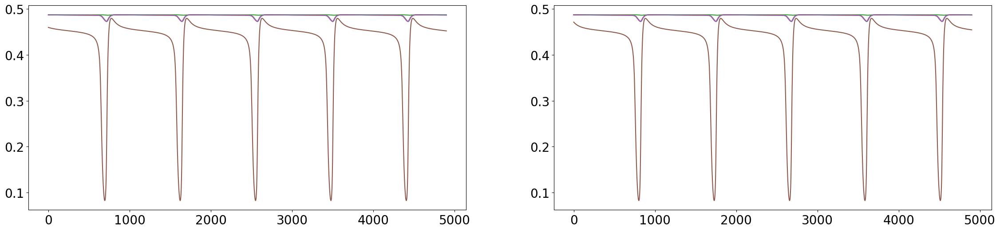

1.6 1.0


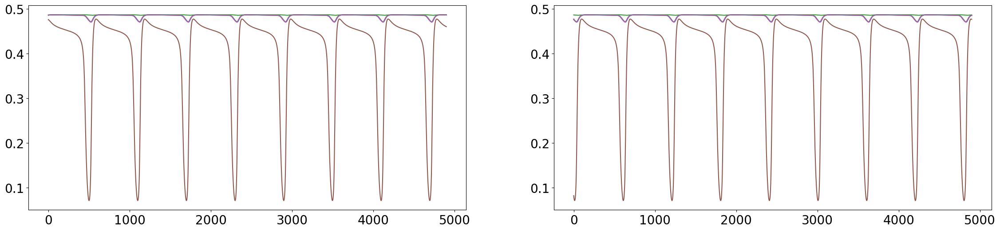

1.6 1.2000000000000002


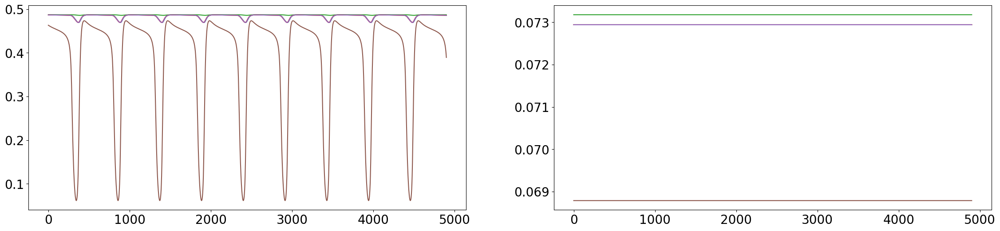

1.6 1.4000000000000001


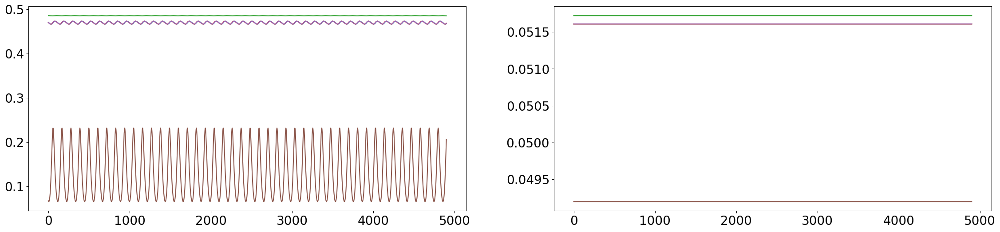

1.6 1.6
1.6 1.8
1.6 2.0
1.6 2.2
1.6 2.4000000000000004
1.6 2.6
1.6 2.8000000000000003
1.8 0.0
1.8 0.2
1.8 0.4
1.8 0.6000000000000001
1.8 0.8
1.8 1.0
1.8 1.2000000000000002
1.8 1.4000000000000001
1.8 1.6
1.8 1.8
1.8 2.0
1.8 2.2
1.8 2.4000000000000004
1.8 2.6
1.8 2.8000000000000003
2.0 0.0
2.0 0.2
2.0 0.4
2.0 0.6000000000000001
2.0 0.8
2.0 1.0
2.0 1.2000000000000002
2.0 1.4000000000000001
2.0 1.6
2.0 1.8
2.0 2.0
2.0 2.2
2.0 2.4000000000000004
2.0 2.6
2.0 2.8000000000000003
2.2 0.0
2.2 0.2
2.2 0.4
2.2 0.6000000000000001
2.2 0.8
2.2 1.0
2.2 1.2000000000000002
2.2 1.4000000000000001
2.2 1.6
2.2 1.8
2.2 2.0
2.2 2.2
2.2 2.4000000000000004
2.2 2.6
2.2 2.8000000000000003
2.4000000000000004 0.0
2.4000000000000004 0.2
2.4000000000000004 0.4
2.4000000000000004 0.6000000000000001
2.4000000000000004 0.8
2.4000000000000004 1.0
2.4000000000000004 1.2000000000000002
2.4000000000000004 1.4000000000000001
2.4000000000000004 1.6
2.4000000000000004 1.8
2.4000000000000004 2.0
2.4000000000000004 2.2
2.400000

In [32]:
for ci in range(len(coupling_array)):

    print("-----------------------------------------------------------", ci)

    #if ci not in [1]: continue

    for e_ in eext:
        
        for i_ in iext:

            print(e_, i_)
        
            model = WCModel(Cmat=cmat, Dmat=dmat)
            model.params.K_gl = coupling_array[ci]
            dt = 0.1
            model.params.dt = dt

            dur = 4000.
            measure_dur = 30.
            i00, i01 = 0, 100
            i10, i11 = 20000, 20100

            model.params['duration'] = dur 
            test_input = ZeroInput().generate_input(duration=model.params['duration']+model.params.dt, dt=model.params.dt)
            test_input[:,i00:i01] = 6.
            test_input[:,i10:i11] = -6.
            model.params.exc_ext_baseline = e_
            model.params.inh_ext_baseline = i_
            model.params.exc_ext = test_input

            model.run()

            if np.var(model.exc[0,i01+add_ind:i10]) < 1e-6 and np.var(model.exc[0,i11+add_ind:]) < 1e-6:
                continue            

            fig, ax = plt.subplots(1,2, figsize=(28,6))

            for n in range(N):
                ax[0].plot(model.exc[n,i01+add_ind:i10])
                ax[1].plot(model.exc[n,i11+add_ind:])

            plt.show()